In [1]:
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
from matplotlib.pyplot import rc_context
import os
import seaborn as sns
import importlib
import re

In [2]:
import degSummary
from scanpyColor import godsnot_102

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=150, facecolor='white', dpi_save=600)

scanpy==1.8.2 anndata==0.7.5 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.3 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.10.3 louvain==0.8.0 pynndescent==0.5.8


In [4]:
sns.set_theme(style="ticks")

# Load data

In [5]:
os.chdir('../..')

In [6]:
pwd

'/data/tcl/Project/ADFCA'

In [7]:
age_L=['10', '20', '30']
ageColor_L=['#1F77B4', '#FF7F0E', '#2CA02C', '#D62728']
ageColor_L2=['#009ACD', '#FF7D40', '#2CA02C', '#D62728']
ggplotColor3_L= ["#F8766D", "#00BA38", "#619CFF"]
set2Color_L=["#66C2A5", "#E9936A", "#A89BB0"]

In [8]:
genotype_L=['control', 'AB42', 'hTau']

In [9]:
figureFolder = 'Analysis/Figure'
os.makedirs(figureFolder, exist_ok=True)

In [10]:
figureDataFolder=f'Analysis/Figure'
os.makedirs(figureDataFolder, exist_ok=True)
figure1Folder=f'{figureDataFolder}/Figure1'
os.makedirs(figure1Folder, exist_ok=True)
figure2Folder=f'{figureDataFolder}/Figure2'
os.makedirs(figure2Folder, exist_ok=True)
figure2PicFolder=f'{figure2Folder}/pic'
os.makedirs(figure2PicFolder, exist_ok=True)

In [11]:
cellnFolder=f'{figure2Folder}/cellN'
os.makedirs(cellnFolder, exist_ok=True)

compositionFolder=f'{figure2Folder}/composition'
os.makedirs(compositionFolder, exist_ok=True)

In [12]:
degControlFolder=f'{figure2Folder}/DEG_toControl'
os.makedirs(degControlFolder, exist_ok=True)

degCelltypeFolder=f'{figure2Folder}/DEG_celltype'
os.makedirs(degCelltypeFolder, exist_ok=True)

degGenoControlFolder=f'{figure2Folder}/DEG_genotype_toControl'
os.makedirs(degGenoControlFolder, exist_ok=True)

degGenoControlBroadFolder=f'{figure2Folder}/DEG_genotype_toControl_broad'
os.makedirs(degGenoControlBroadFolder, exist_ok=True)

degGenoControlGroupFolder=f'{figure2Folder}/DEG_genotype_toControl_group'
os.makedirs(degGenoControlGroupFolder, exist_ok=True)

In [13]:
degSummaryFolder=f'{figure2Folder}/degSummary'
os.makedirs(degSummaryFolder, exist_ok=True)

In [14]:
degCompositionSummary=f'{figure2Folder}/degCompositionSummary'
os.makedirs(degCompositionSummary, exist_ok=True)

In [15]:
figure3Folder=f'{figureDataFolder}/Figure3'
os.makedirs(figure3Folder, exist_ok=True)
figure3PicFolder=f'{figure3Folder}/pic'
os.makedirs(figure3PicFolder, exist_ok=True)

In [16]:
goCelltypeFolder=f'{figure3Folder}/GO_compareCelltype'
os.makedirs(goCelltypeFolder, exist_ok=True)
goCelltypeIdFolder=f'{goCelltypeFolder}/geneID'
os.makedirs(goCelltypeIdFolder, exist_ok=True)
goCelltypeNameFolder=f'{goCelltypeFolder}/geneName'
os.makedirs(goCelltypeNameFolder, exist_ok=True)

goFolder=f'{figure3Folder}/GO_compareToControl'
os.makedirs(goFolder, exist_ok=True)
goIdFolder=f'{goFolder}/geneID'
os.makedirs(goIdFolder, exist_ok=True)
goNameFolder=f'{goFolder}/geneName'
os.makedirs(goNameFolder, exist_ok=True)

In [17]:
revigoFolder=f'{figure3Folder}/revigo_compareToControl'
os.makedirs(revigoFolder, exist_ok=True)

In [18]:
hsc70HighFolder=f'{figure3Folder}/hsc70-3_high'
os.makedirs(hsc70HighFolder, exist_ok=True)

In [19]:
annotFolder='Analysis/5.ADFCA_AFCA_transfer_cellbender_scDblFinder'

In [20]:
genoAge_L = ['control_10', 'control_20', 'control_30', 'AB42_10', 'AB42_20', 'hTau_20', 'hTau_30']

In [21]:
genoAgeSex_L = ['control_10_female', 'control_20_female', 'control_30_female', 'control_10_male', 'control_20_male', 'control_30_male', 
                'AB42_10_female', 'AB42_20_female', 'AB42_10_male', 'AB42_20_male', 
                'hTau_20_female', 'hTau_30_female', 'hTau_20_male', 'hTau_30_male']

In [22]:
# ageCompare
genoCompare_Df = pd.DataFrame(columns=['expSet', 'controlSet', 'age'])
# genoCompare_Df['expSet'] = [exp for exp in genoAge_L if 'control' not in exp]
# genoCompare_Df['controlSet'] = pd.Categorical(['control_' + '_'.join(genoAge.split('_')[1:]) for genoAge in genoCompare_Df['expSet']])


genoCompare_Df.loc[0,:] = ['AB42', 'control_inAB42', '10,20']
genoCompare_Df.loc[1,:] = ['hTau', 'control_inTau', '20,30']
genoCompare_Df

,expSet,controlSet,age
0,AB42,control_inAB42,"10,20"
1,hTau,control_inTau,"20,30"


# Fig 3A-B

## Load data

In [30]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [24]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    layers: 'logNormalize_exp', 'umi_counts'

## Plot tsne: genotype differences

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


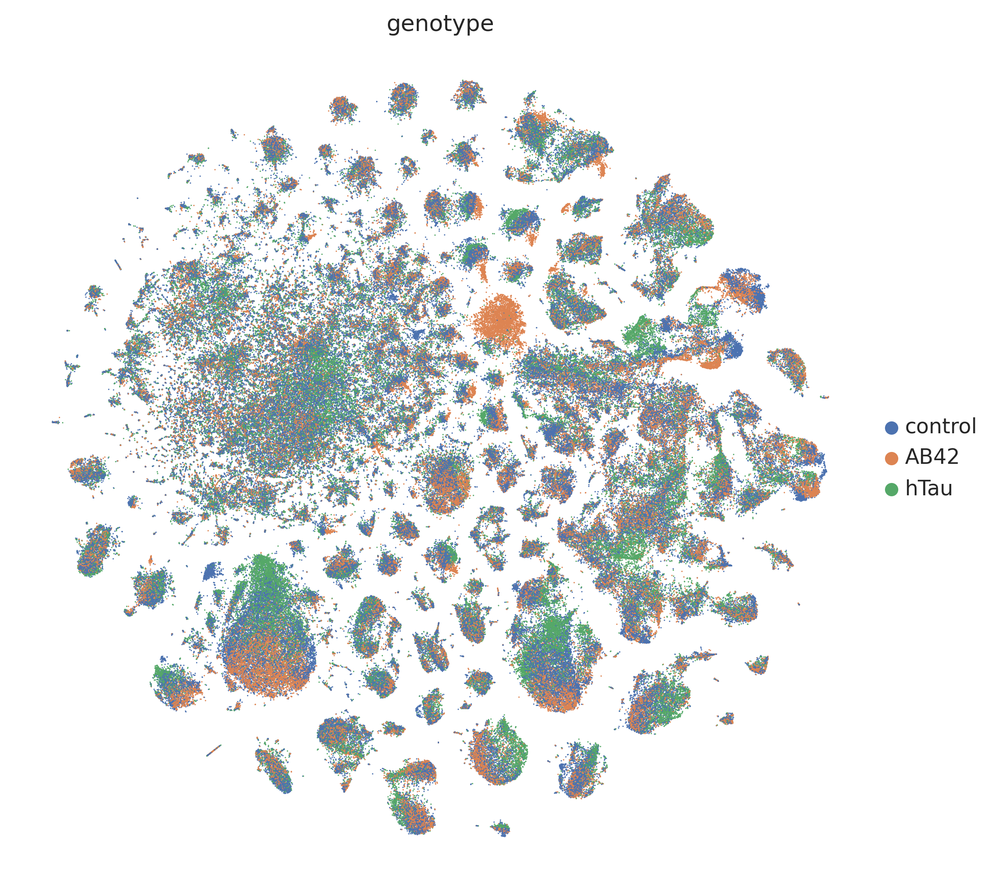

In [27]:
with rc_context({'figure.figsize': (8, 8)}):
    sc.pl.tsne(adata_head, color='genotype', size=2, frameon=False,
               save=f'_adata_head_genotype.pdf'
               ) # 
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

## Plot tsne: Hsc70-3 and Ldh expression

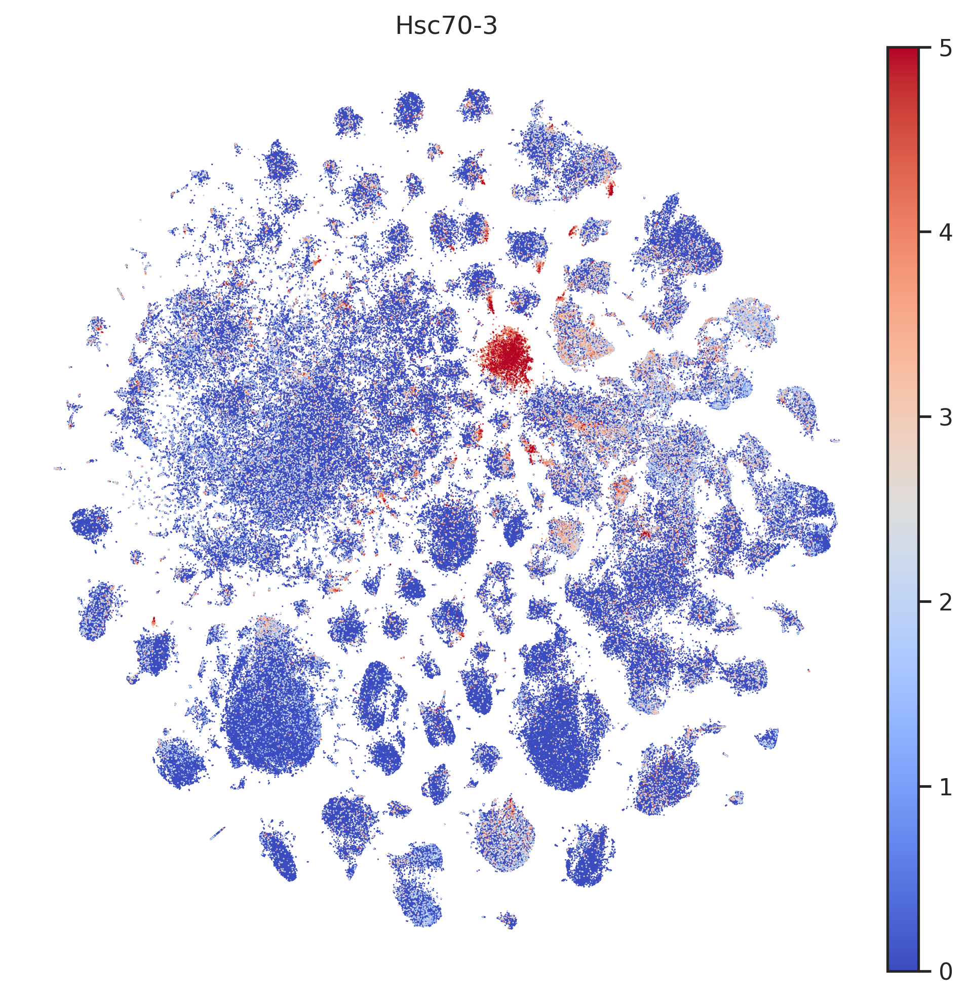

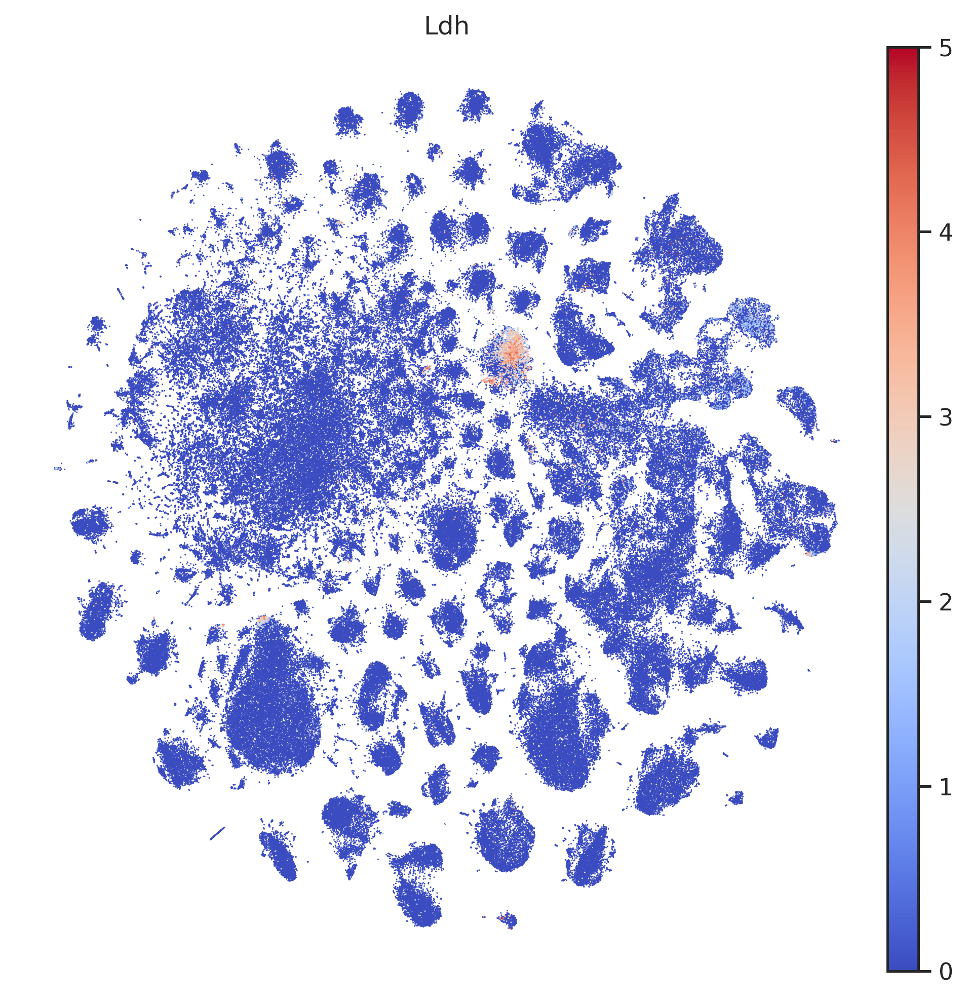

In [33]:
with rc_context({'figure.figsize': (8, 8)}):
    for gene in ['Hsc70-3', 'Ldh']:
        sc.pl.tsne(adata_head, color=gene, size=2, frameon=False, cmap='coolwarm', vmax=5,
                   save=f'_adata_{gene}_expression_coolwarm.pdf') # 
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

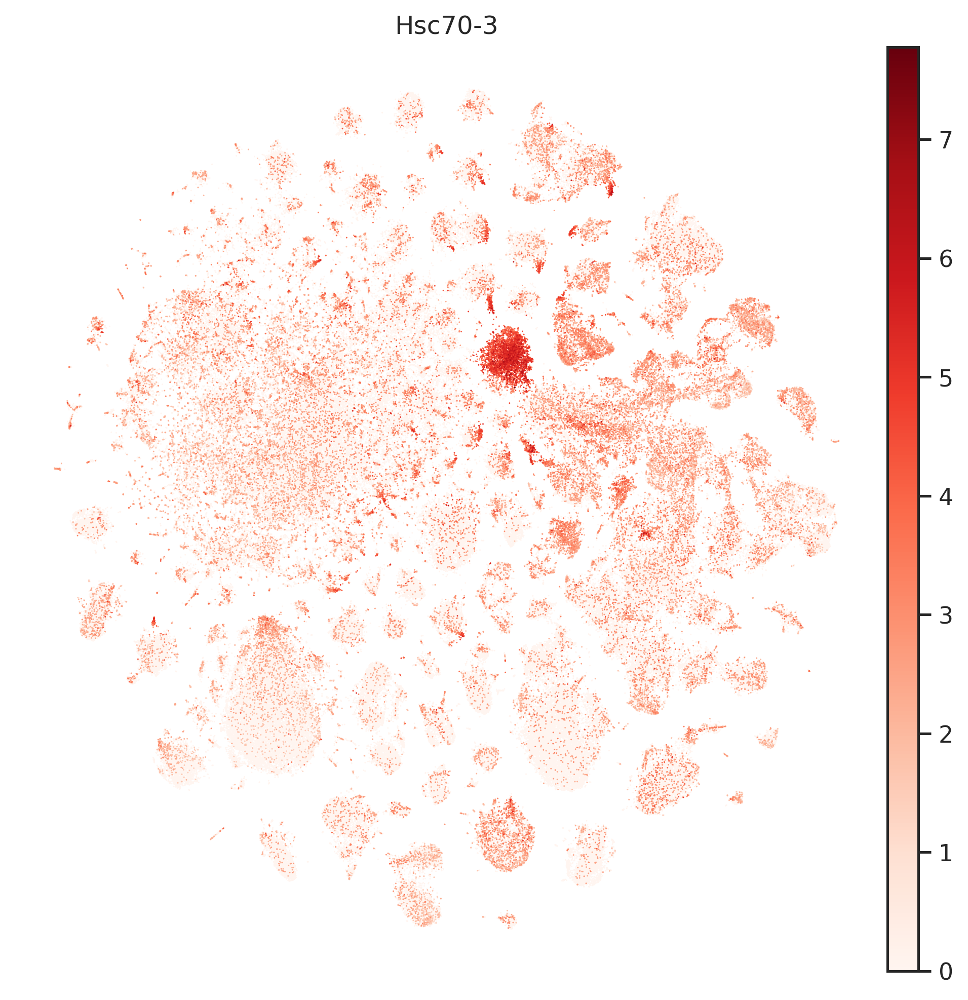

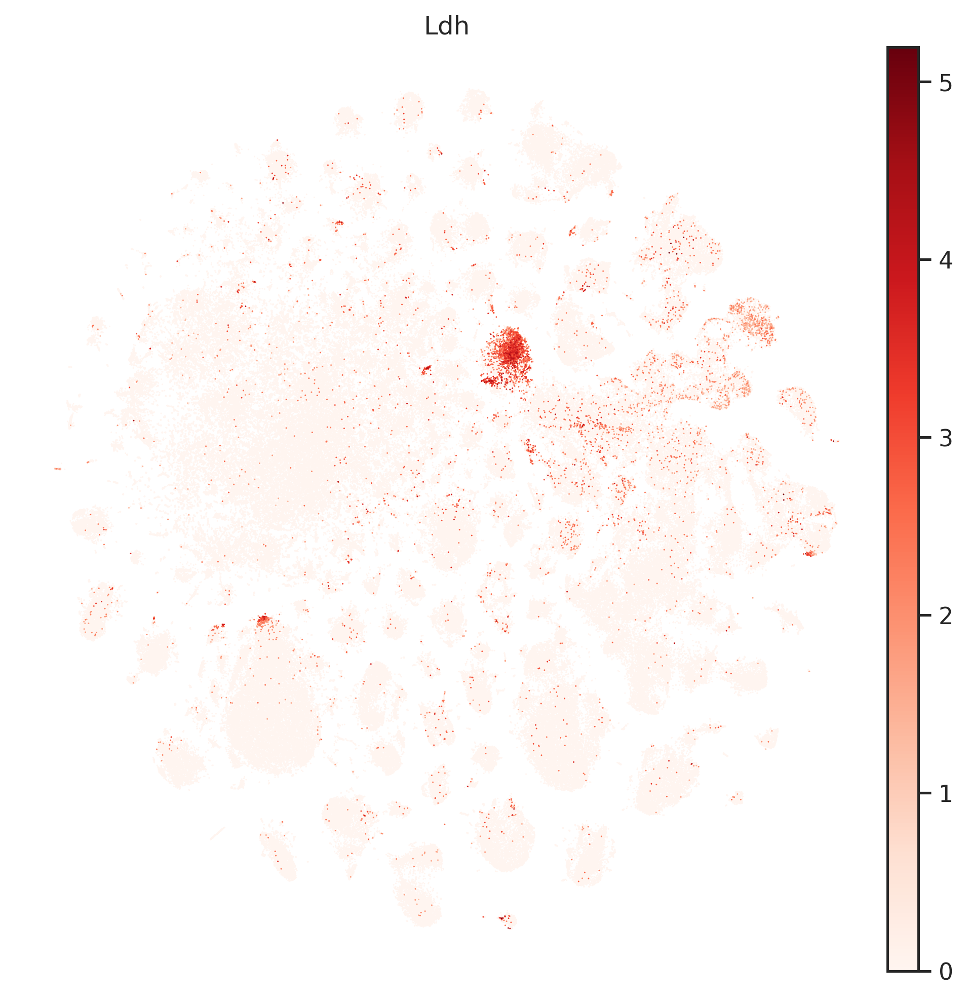

In [35]:
with rc_context({'figure.figsize': (8, 8)}):
    for gene in ['Hsc70-3', 'Ldh']:
        sc.pl.tsne(adata_head, color=gene, size=2, frameon=False, cmap='Reds', #vmax=5,
                   save=f'_adata_{gene}_expression_Reds.pdf') # 
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

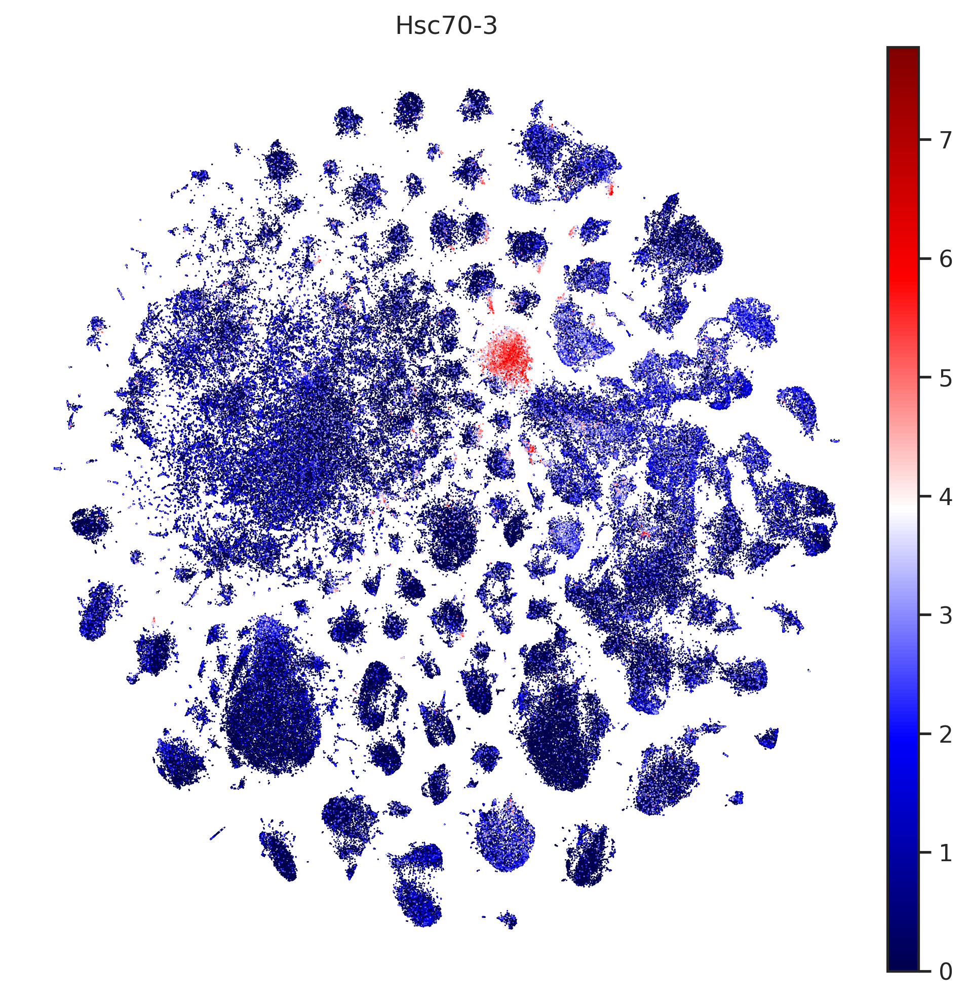

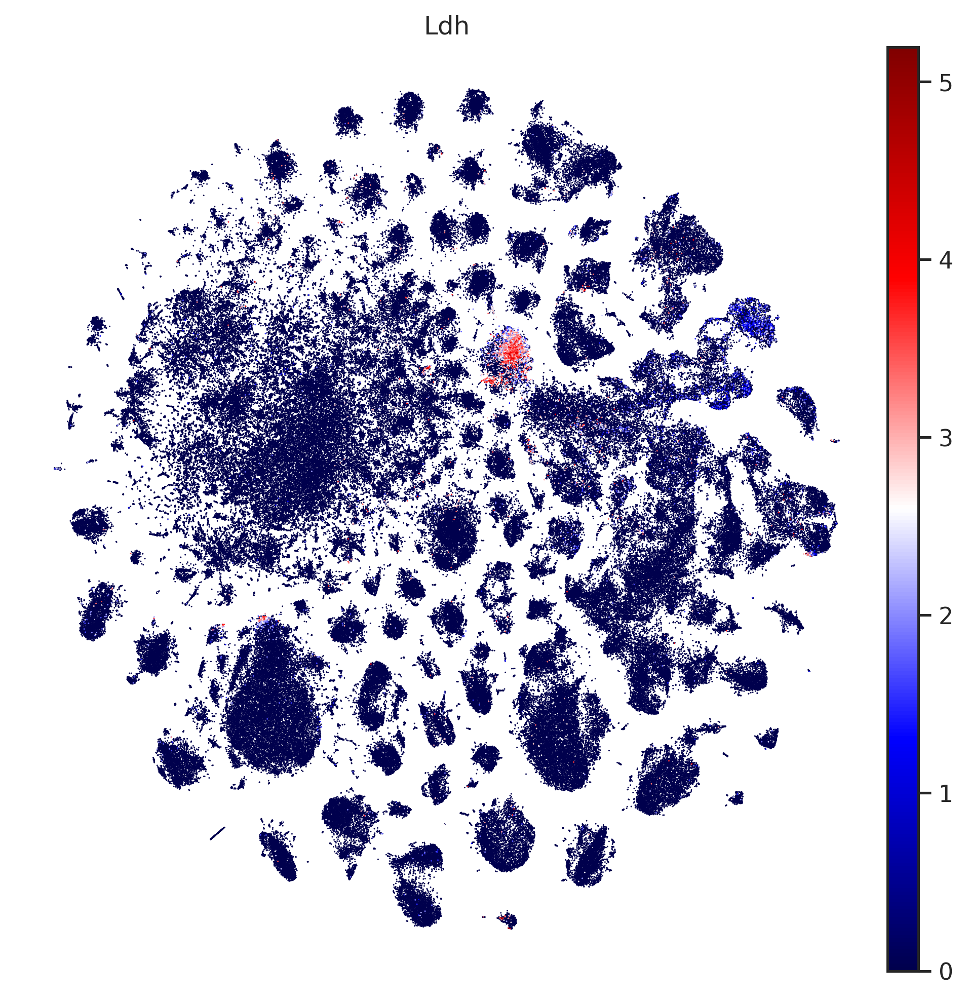

In [25]:
with rc_context({'figure.figsize': (8, 8)}):
    for gene in ['Hsc70-3', 'Ldh']:
        sc.pl.tsne(adata_head, color=gene, size=2, frameon=False, cmap='seismic', #vmax=5,
                   save=f'_adata_{gene}_expression_seismic.pdf') # 
    
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

# DEG, ER stress

## Load data

In [21]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [22]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    layers: 'logNormalize_exp', 'umi_counts'

In [23]:
genoCompare_Df

,expSet,controlSet,age
0,AB42,control_inAB42,"10,20"
1,hTau,control_inTau,"20,30"


## select (1) AB42-specific cluster and (2) 10 cell types suspectible to AB42

In [24]:
dotplot_Df = pd.read_csv(f'{cellnFolder}/head_ratioDf_dotplot_Df_genotypeGroup.csv')
dotplot_Df.sort_values(by='log2ratio', inplace=True)
dotplot_Df

,Unnamed: 0,annotation,genotypeCompare,log2ratio,cellN
67,67,ABeta42-specific cluster,hTau/control_inTau_ratio,-0.691093,1003
13,13,lobula columnar neuron LC16,AB42/control_inAB42_ratio,-0.643901,391
27,27,medullary intrinsic neuron Mi1,AB42/control_inAB42_ratio,-0.582860,1221
68,68,pigment cell,hTau/control_inTau_ratio,-0.527989,2420
25,25,lamina monopolar neuron L2,AB42/control_inAB42_ratio,-0.509909,1633
...,...,...,...,...,...
131,131,transmedullary neuron Tm4,hTau/control_inTau_ratio,0.518802,676
61,61,T neuron T4/T5,AB42/control_inAB42_ratio,0.543295,4739
132,132,alpha'/beta' Kenyon cell,hTau/control_inTau_ratio,0.557416,832
133,133,transmedullary neuron Tm9,hTau/control_inTau_ratio,0.570144,485


In [25]:
celltype_L = dotplot_Df[dotplot_Df.genotypeCompare == 'AB42/control_inAB42_ratio'].annotation.to_list()
celltype_L = celltype_L[:10] + celltype_L[-1:]
celltype_L

['lobula columnar neuron LC16',
 'medullary intrinsic neuron Mi1',
 'lamina monopolar neuron L2',
 'auditory sensory neuron',
 'olfactory receptor neuron',
 'lobula columnar neuron LC17',
 'lobula plate-lobula columnar LPLC2',
 'adult lamina epithelial/marginal glial cell',
 'lamina intrinsic neuron',
 'olfactory projection neuron',
 'ABeta42-specific cluster']

In [26]:
celltype_L

['lobula columnar neuron LC16',
 'medullary intrinsic neuron Mi1',
 'lamina monopolar neuron L2',
 'auditory sensory neuron',
 'olfactory receptor neuron',
 'lobula columnar neuron LC17',
 'lobula plate-lobula columnar LPLC2',
 'adult lamina epithelial/marginal glial cell',
 'lamina intrinsic neuron',
 'olfactory projection neuron',
 'ABeta42-specific cluster']

In [27]:
erstressGene_L = ['Hsc70-3', 'CaBP1', 'ERp60', 'PHGPx', 'Xbp1', 'cnc']

## HVG to tsne: 10 cell types, no hTau

In [164]:
npcs = 20

In [165]:
adata_sub = adata_head[(adata_head.obs.adfca_annotation.isin(celltype_L)) & (adata_head.obs.genotype != 'hTau')].raw.to_adata()
adata_sub

AnnData object with n_obs × n_vars = 15962 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'adfca_annotation_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

In [166]:
adata_sub.uns['log1p']["base"] = None

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


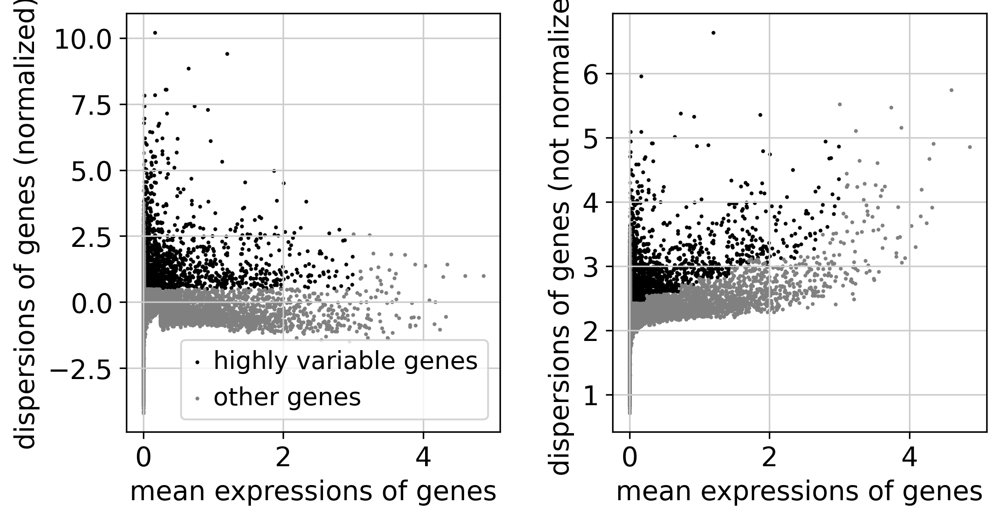

highly_variable
False    14301
True      1918
Name: count, dtype: int64

In [167]:
# HVG
sc.pp.highly_variable_genes(adata_sub, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata_sub)
adata_sub.var['highly_variable'].value_counts()

In [168]:
hvg_L = adata_sub.var[ 
        (adata_sub.var.means > 0.0125) & 
        (adata_sub.var.means <= 3 ) ].dispersions_norm.sort_values(ascending=False)[:2000].index.to_list()
print('hvg #: ', len(hvg_L))
adata_sub.var['highly_variable']= [True if var in hvg_L else False for var in adata_sub.var_names ]
adata_sub.var['highly_variable'].value_counts()

hvg #:  2000


highly_variable
False    14219
True      2000
Name: count, dtype: int64

In [169]:
adata_sub.raw = adata_sub
adata_sub = adata_sub[:, adata_sub.var.highly_variable]

# sc.pp.regress_out(adata_sub, ['n_counts'])
sc.pp.scale(adata_sub, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [170]:
adata_sub

AnnData object with n_obs × n_vars = 15962 × 2000
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'adfca_annotation_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

computing PCA
    on highly variable genes
    with n_comps=80
    finished (0:00:02)


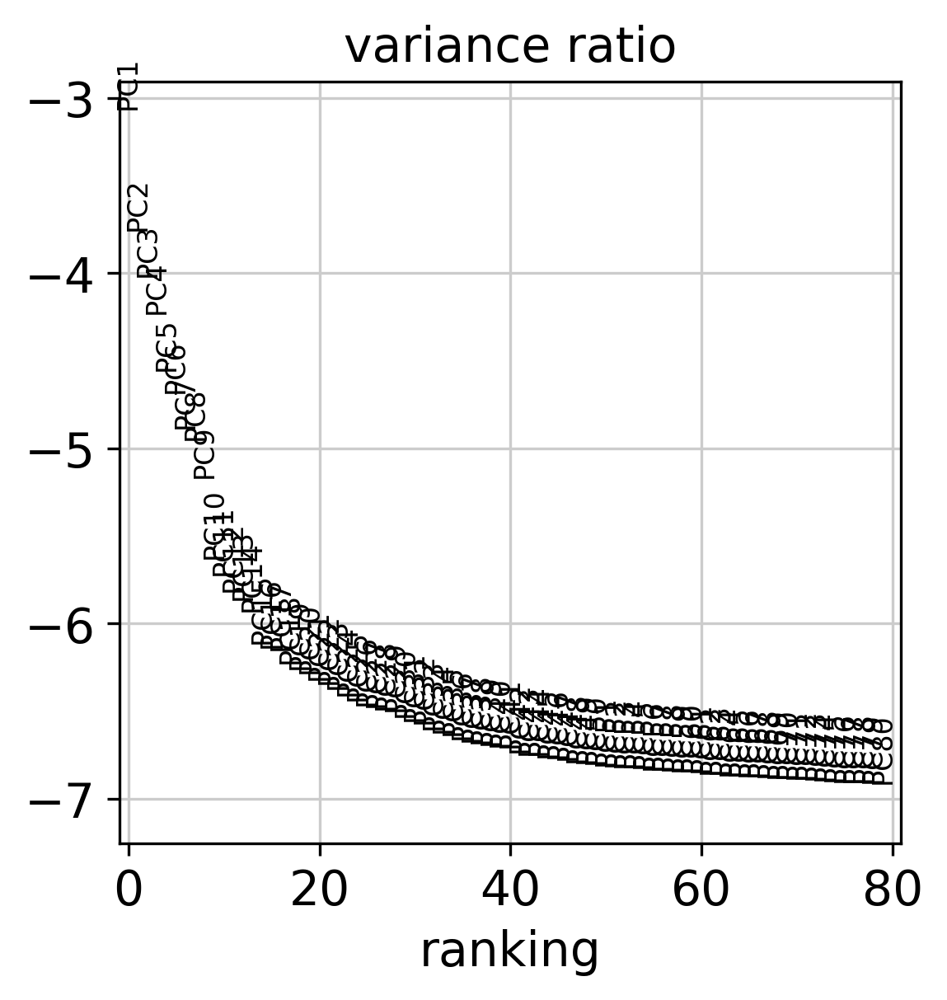

In [171]:
# PCA
sc.tl.pca(adata_sub, svd_solver='arpack', n_comps=80)
sc.pl.pca_variance_ratio(adata_sub, log=True, n_pcs=80)

In [172]:
# nn
sc.pp.neighbors(adata_sub, n_neighbors=15, n_pcs= npcs)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [173]:
sc.tl.tsne(adata_sub, n_jobs=60, n_pcs=npcs)
sc.tl.umap(adata_sub)
sc.tl.leiden(adata_sub)

computing tSNE
    using 'X_pca' with n_pcs = 20
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:22)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)
running Leiden clustering
    finished: found 28 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


In [174]:
adata_sub.write(f'{hsc70HighFolder}/hscHigh_1.HVG_toUMAP_bottom10_noTau.h5ad')

### plot

In [175]:
adata_sub = sc.read(f'{hsc70HighFolder}/hscHigh_1.HVG_toUMAP_bottom10_noTau.h5ad')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


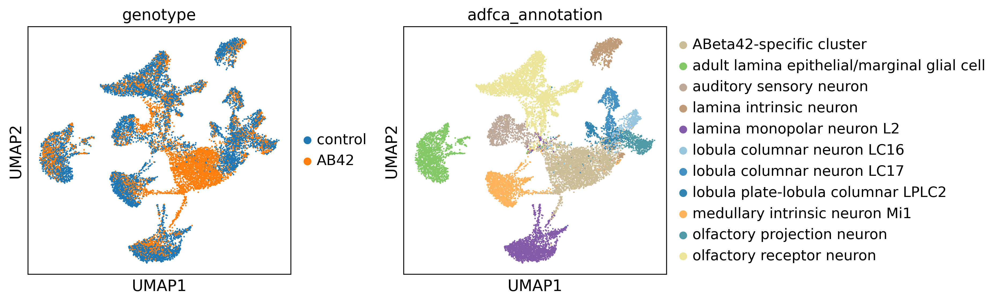

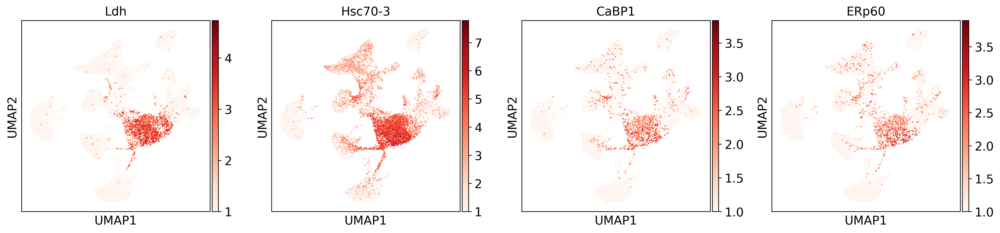

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


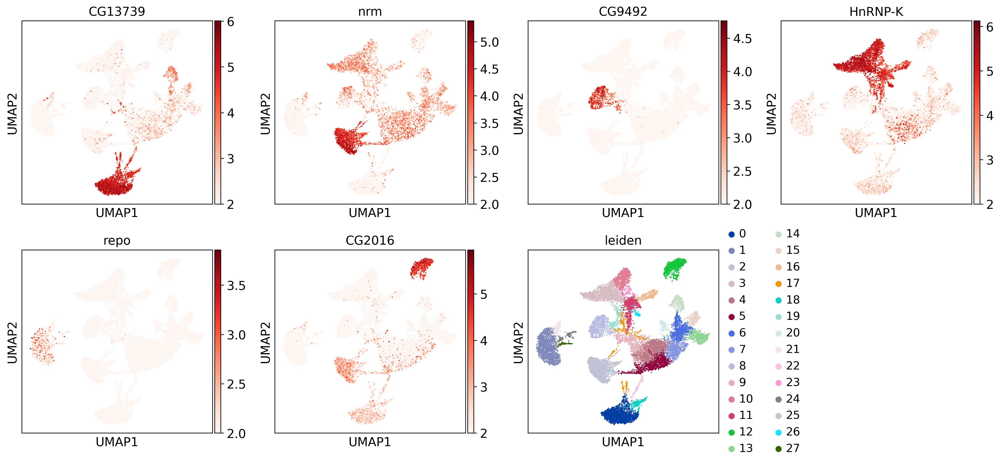

In [176]:
sc.pl.umap(adata_sub, color=['genotype', 'adfca_annotation'], wspace=0.3)
sc.pl.umap(adata_sub, color=['Ldh']+ erstressGene_L[:3], cmap='Reds', vmin=1) # 'CG2016', 'Octbeta1R', 
sc.pl.umap(adata_sub, color=['CG13739', 'nrm', 'CG9492', 'HnRNP-K', 'repo', 'CG2016', 'leiden'], cmap='Reds', vmin=2) # 'CG43078', 'CG2016', 'Octbeta1R', 
# sc.pl.umap(adata_sub, color=['VAChT', 'Gad1', 'VGlut'], cmap='Reds', vmin=1) 
# sc.pl.umap(adata_sub, color=['Hsc70-3', 'Ldh', ], cmap='Reds')


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


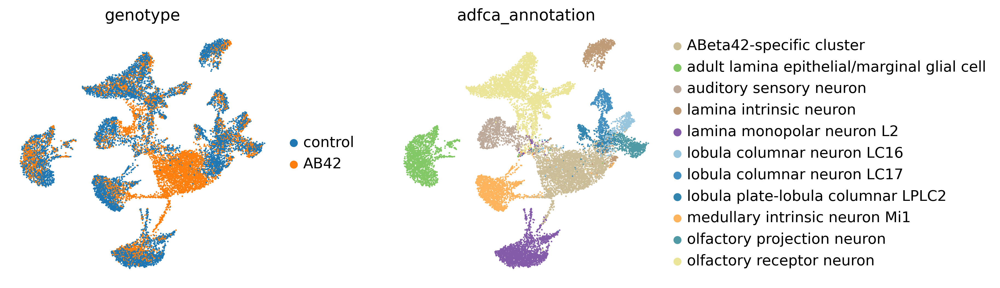

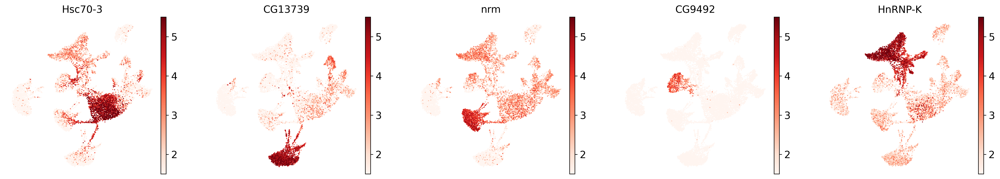

In [177]:
# figs, axs = plt.subplots(2, 1, figsize=(12, 6))
sc.pl.umap(adata_sub, color=['genotype', 'adfca_annotation'], wspace=0.3, frameon=False, save=f'_AB42Bottom10_noTau__genotype__adfca_annotation.pdf')
# sc.pl.umap(adata_sub, color=['Ldh']+ erstressGene_L[:3], cmap='Reds', vmin=1) # 'CG2016', 'Octbeta1R', 
# sc.pl.umap(adata_sub, color=['CG13739', 'nrm', 'CG9492', 'HnRNP-K', 'repo', 'CG2016', 'leiden'], cmap='Reds', vmin=2) # 'CG43078', 'CG2016', 'Octbeta1R', 
# sc.pl.umap(adata_sub, color=['VAChT', 'Gad1', 'VGlut'], cmap='Reds', vmin=1) 
# sc.pl.umap(adata_sub, color=['Hsc70-3', 'Ldh', ], cmap='Reds')

sc.pl.umap(adata_sub, color=['Hsc70-3', 'CG13739', 'nrm', 'CG9492', 'HnRNP-K'], cmap='Reds', vmin=1.5, vmax=5.5, ncols=5, frameon=False, save=f'_AB42Bottom10_noTau__markerExpression.pdf')

for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figure2PicFolder}/{x}')

## HVG to tsne (2 cell types without detecting HVGs)

In [253]:
npcs = 10

In [254]:
adata_sub = sc.read(f'{hsc70HighFolder}/hscHigh_1.HVG_toUMAP_bottom10_noTau.h5ad')

In [255]:
adata_sub = adata_sub[adata_sub.obs.adfca_annotation.isin(celltype_L[1:3]+celltype_L[-1:])]
adata_sub

View of AnnData object with n_obs × n_vars = 7079 × 2000
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'adfca_annotation_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [256]:
# nn
sc.pp.neighbors(adata_sub, n_neighbors=20, n_pcs= npcs)

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [257]:
sc.tl.tsne(adata_sub, n_jobs=60, n_pcs=npcs)
sc.tl.umap(adata_sub)
sc.tl.leiden(adata_sub)

computing tSNE
    using 'X_pca' with n_pcs = 10
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:10)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:11)
running Leiden clustering
    finished: found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


### plot

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


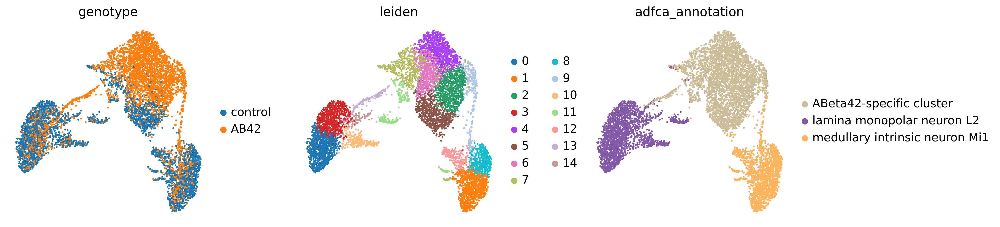

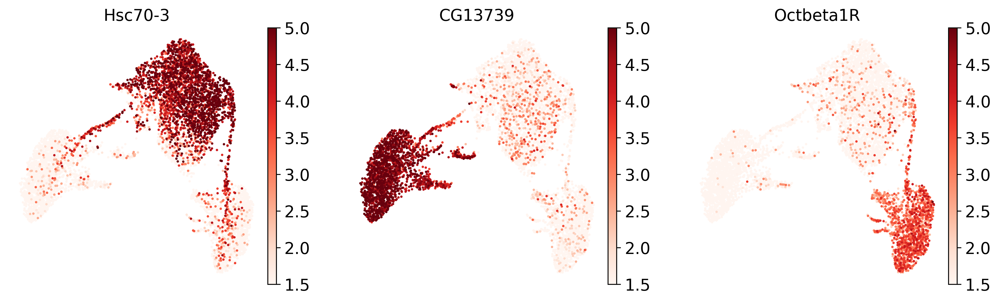

In [259]:
# figs, axs = plt.subplots(2, 1, figsize=(12, 6))
sc.pl.umap(adata_sub, color=['genotype', 'leiden', 'adfca_annotation'], wspace=0.3, frameon=False, save=f'_AB42Bottom10_select2_noTau__genotype__adfca_annotation.pdf')
# sc.pl.umap(adata_sub, color=['Ldh']+ erstressGene_L[:3], cmap='Reds', vmin=1) # 'CG2016', 'Octbeta1R', 
# sc.pl.umap(adata_sub, color=['CG13739', 'nrm', 'CG9492', 'HnRNP-K', 'repo', 'CG2016', 'leiden'], cmap='Reds', vmin=2) # 'CG43078', 'CG2016', 'Octbeta1R', 
# sc.pl.umap(adata_sub, color=['VAChT', 'Gad1', 'VGlut'], cmap='Reds', vmin=1) 
# sc.pl.umap(adata_sub, color=['Hsc70-3', 'Ldh', ], cmap='Reds')

sc.pl.umap(adata_sub, color=['Hsc70-3', 'CG13739', 'Octbeta1R'], cmap='Reds', vmin=1.5, vmax=5, frameon=False, save=f'_AB42Bottom10_select2_noTau__markerExpression.pdf')

for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figure2PicFolder}/{x}')

# Fig: Dotplot of ERstressGenes

In [160]:
dotplot_Df = pd.read_csv(f'{cellnFolder}/{adfcaTissue}_ratioDf_dotplot_Df_genotypeGroup.csv', index_col=0)
dotplot_Df.sort_values(by='log2ratio', inplace=True)
dotplot_Df

,annotation,genotypeCompare,log2ratio,cellN
67,ABeta42-specific cluster,hTau/control_inTau_ratio,-0.691093,1003
13,lobula columnar neuron LC16,AB42/control_inAB42_ratio,-0.643901,391
27,medullary intrinsic neuron Mi1,AB42/control_inAB42_ratio,-0.582860,1221
68,pigment cell,hTau/control_inTau_ratio,-0.527989,2420
25,lamina monopolar neuron L2,AB42/control_inAB42_ratio,-0.509909,1633
...,...,...,...,...
131,transmedullary neuron Tm4,hTau/control_inTau_ratio,0.518802,676
61,T neuron T4/T5,AB42/control_inAB42_ratio,0.543295,4739
132,alpha'/beta' Kenyon cell,hTau/control_inTau_ratio,0.557416,832
133,transmedullary neuron Tm9,hTau/control_inTau_ratio,0.570144,485


In [161]:
cellType_L = ['ABeta42-specific cluster'] + dotplot_Df[ (dotplot_Df.genotypeCompare == 'AB42/control_inAB42_ratio') ].annotation.to_list()[:10]
cellType_L

['ABeta42-specific cluster',
 'lobula columnar neuron LC16',
 'medullary intrinsic neuron Mi1',
 'lamina monopolar neuron L2',
 'auditory sensory neuron',
 'olfactory receptor neuron',
 'lobula columnar neuron LC17',
 'lobula plate-lobula columnar LPLC2',
 'adult lamina epithelial/marginal glial cell',
 'lamina intrinsic neuron',
 'olfactory projection neuron']

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


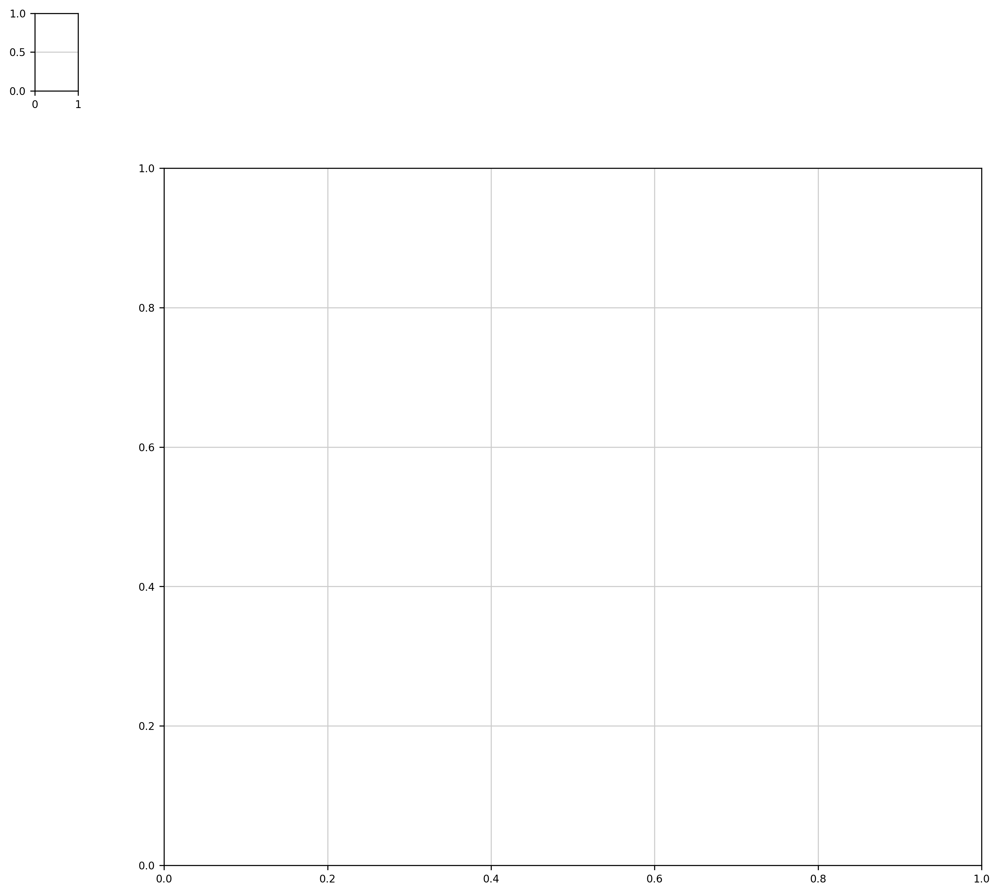

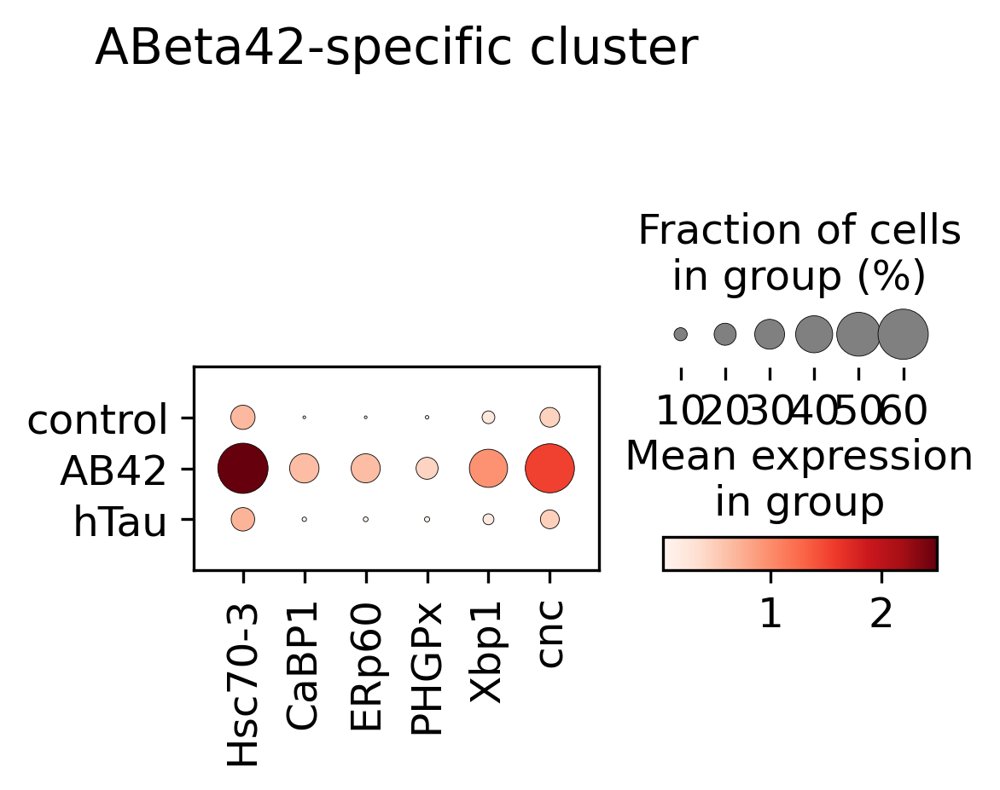

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


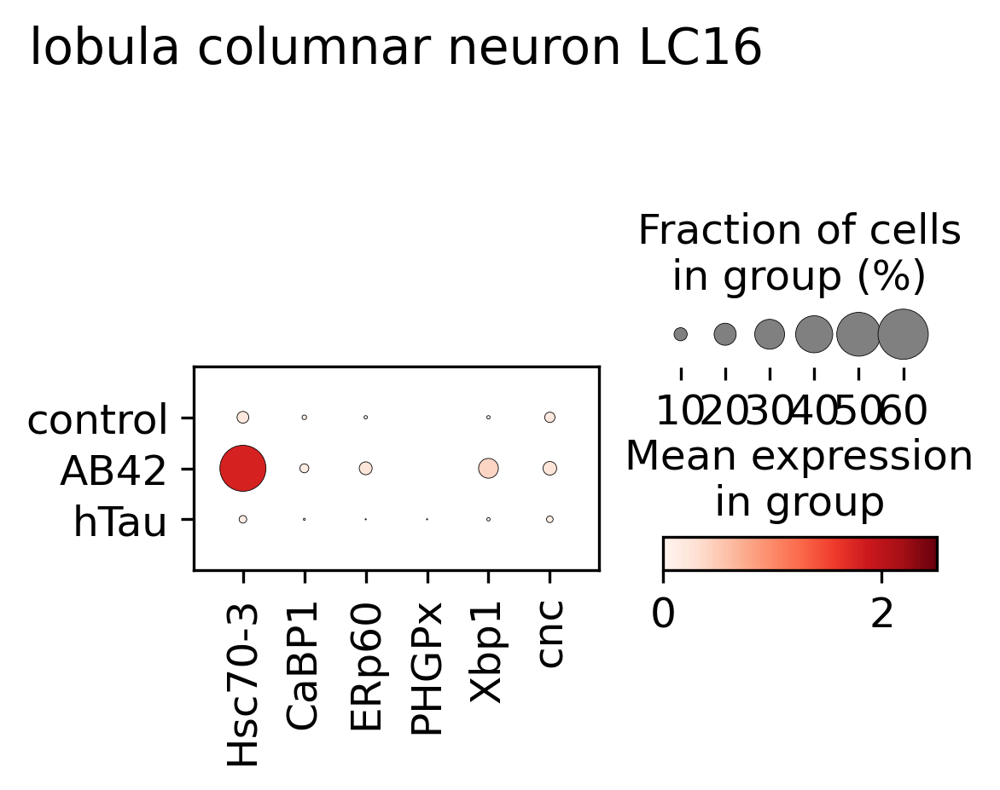

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


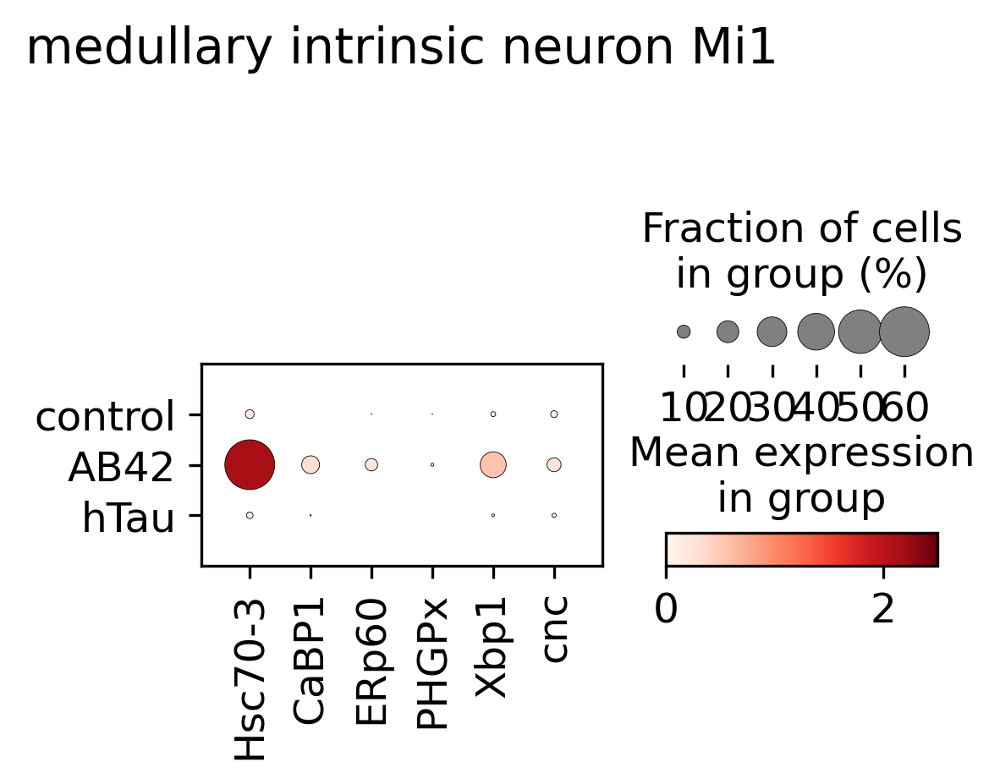

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


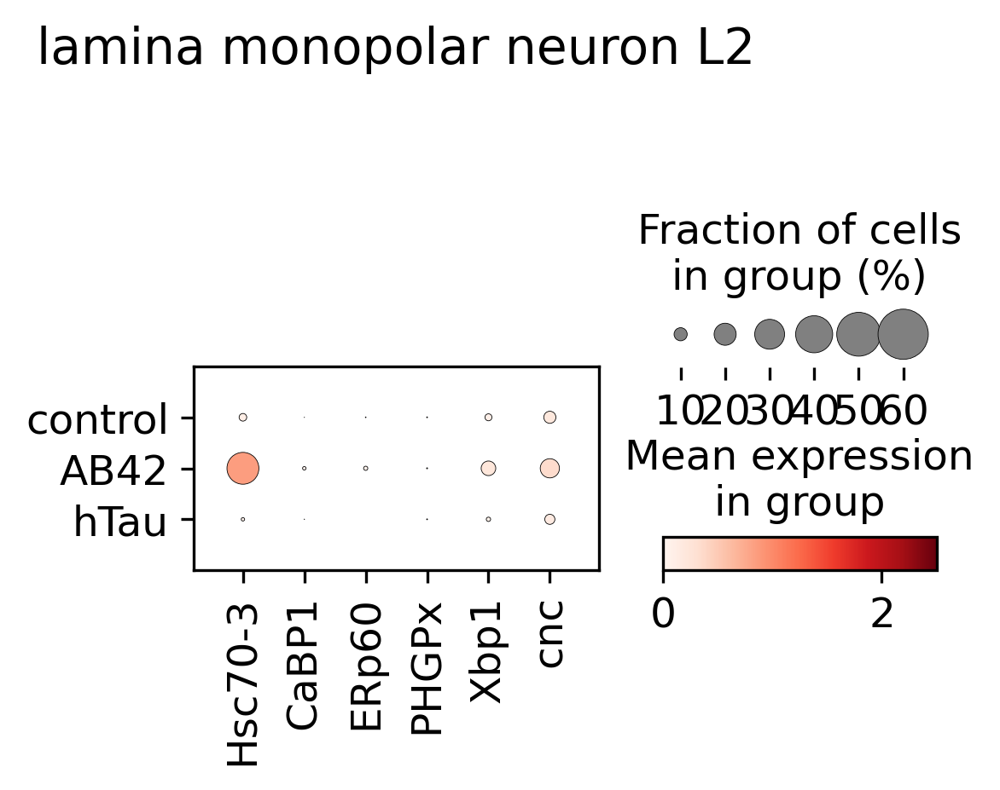

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


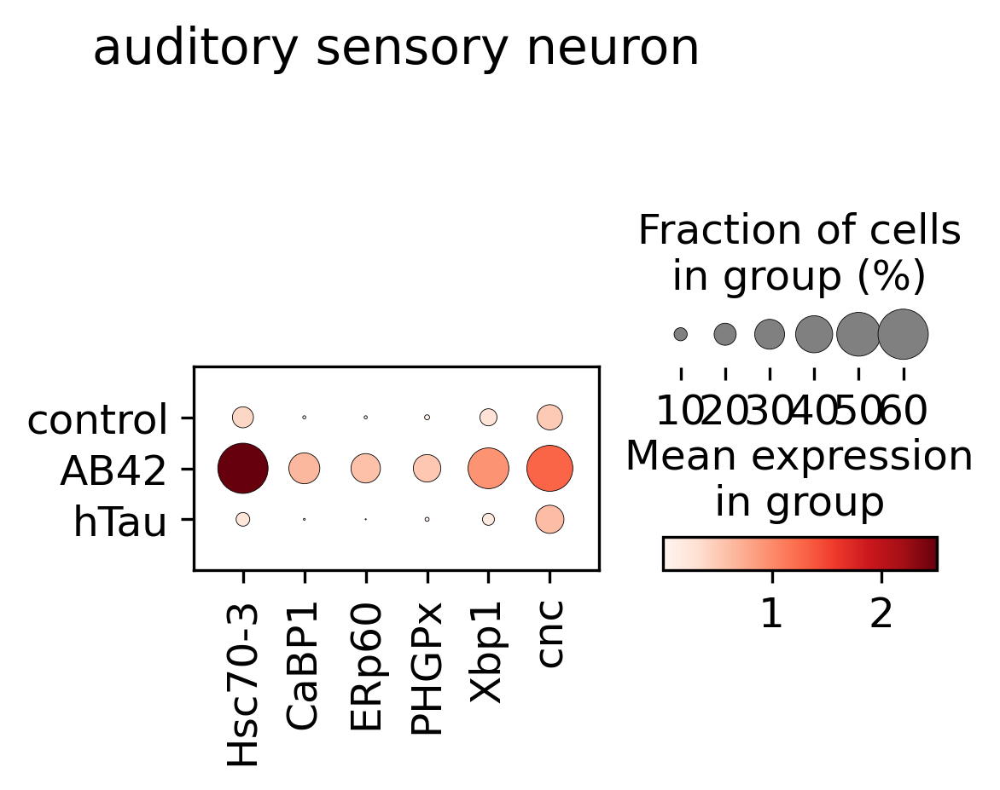

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


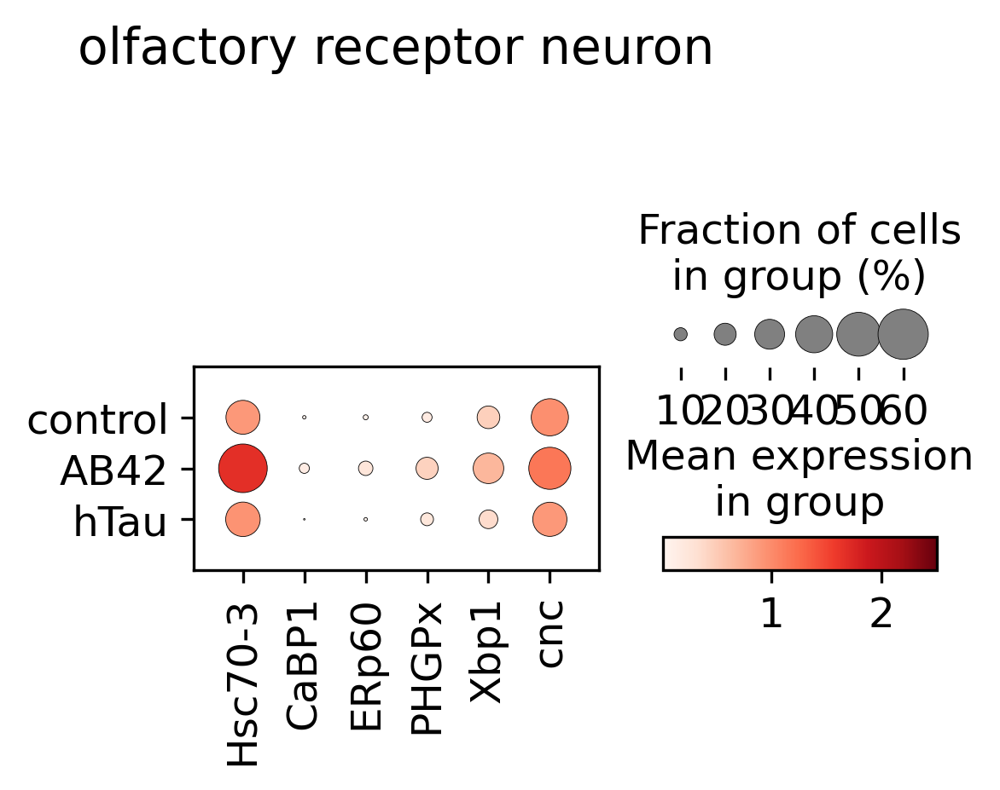

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


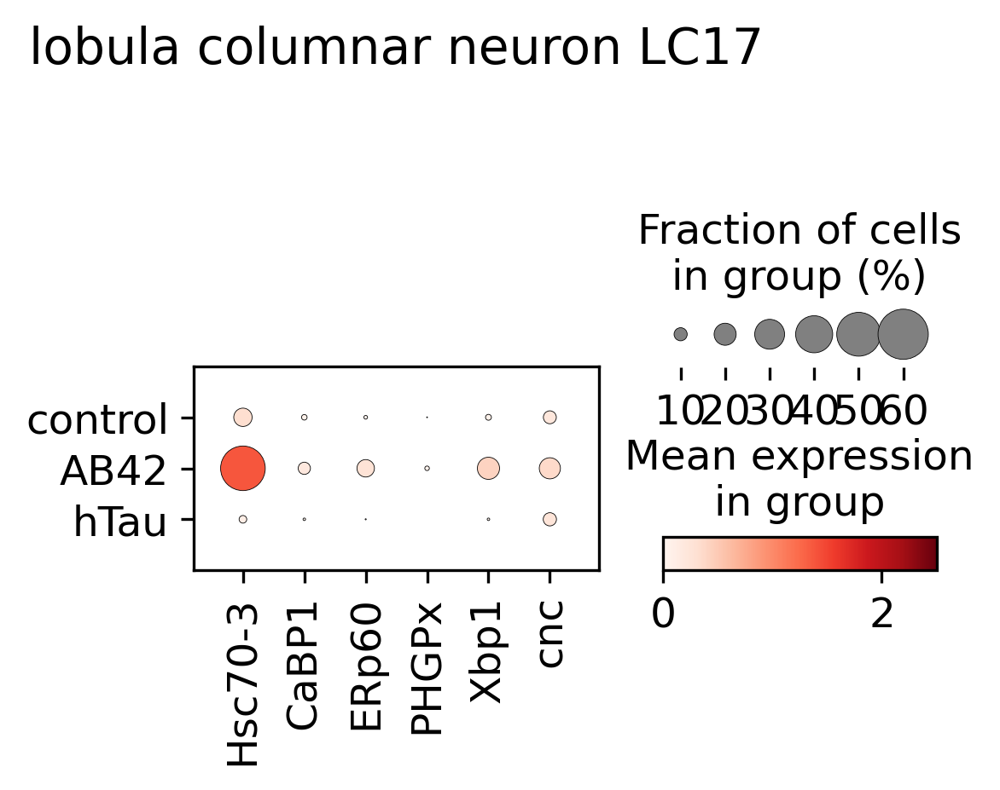

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


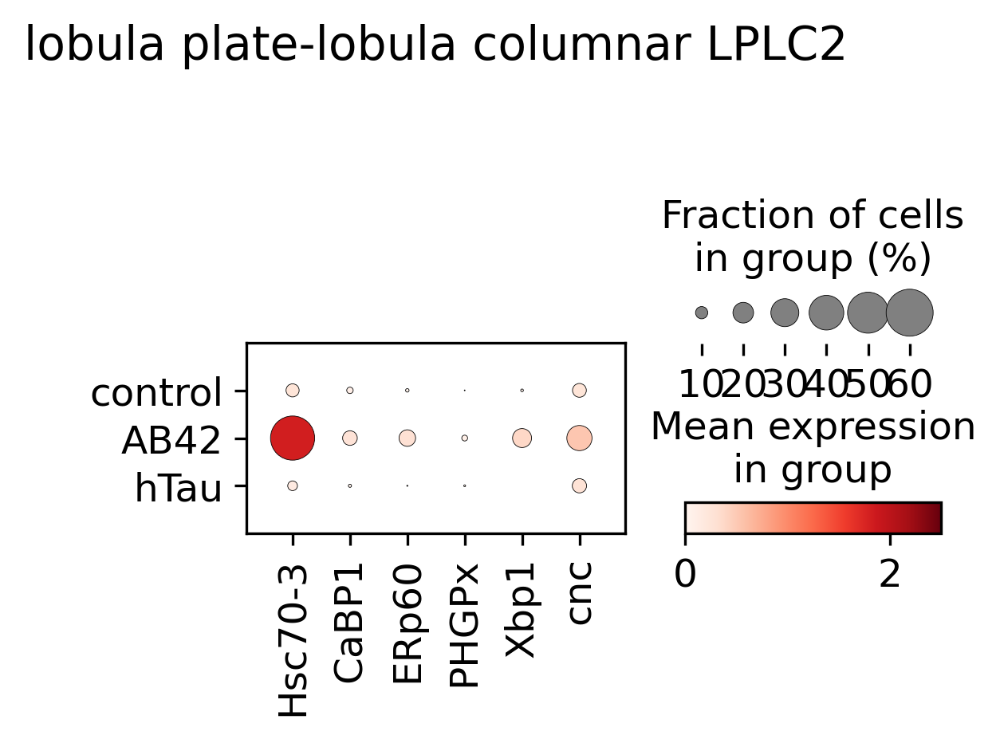

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


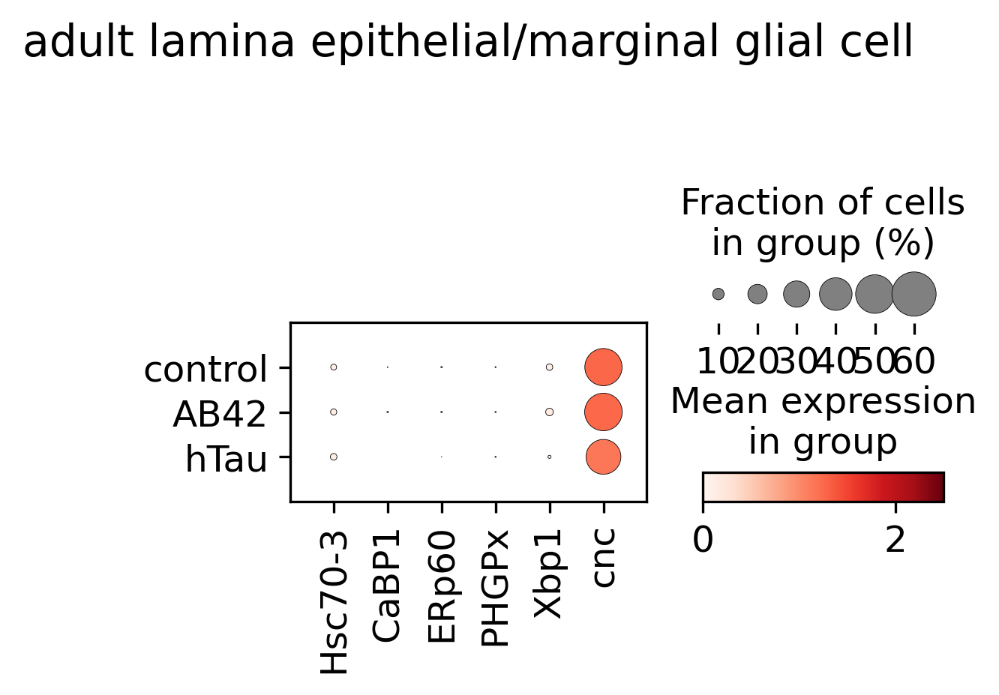

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


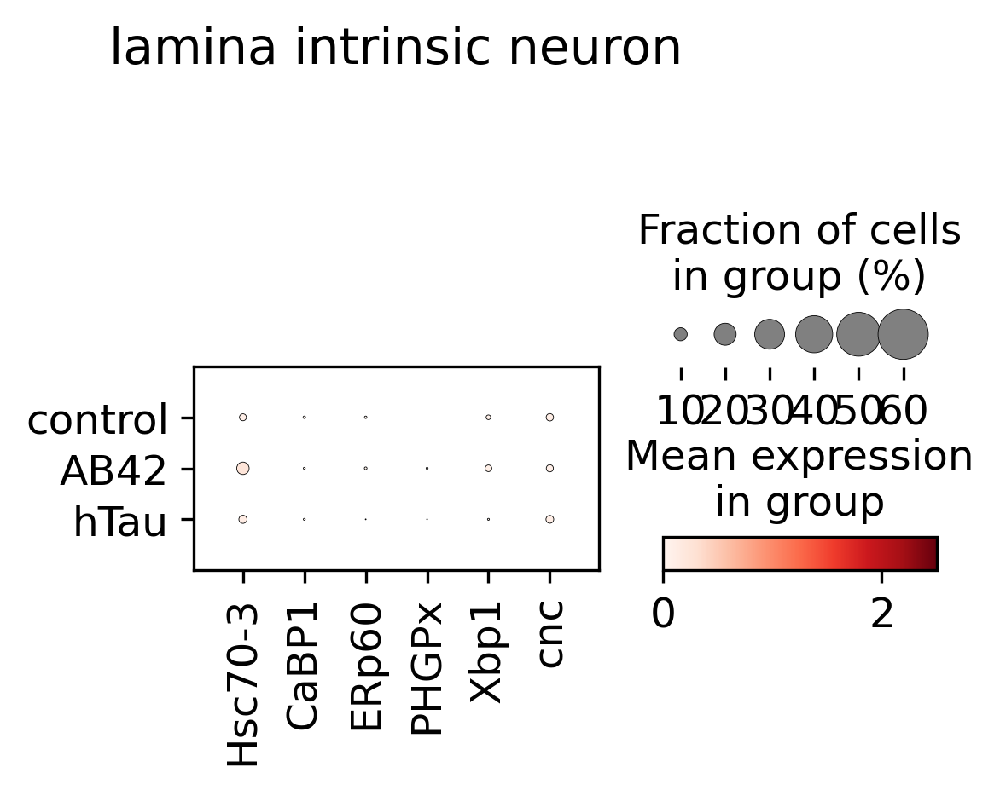

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


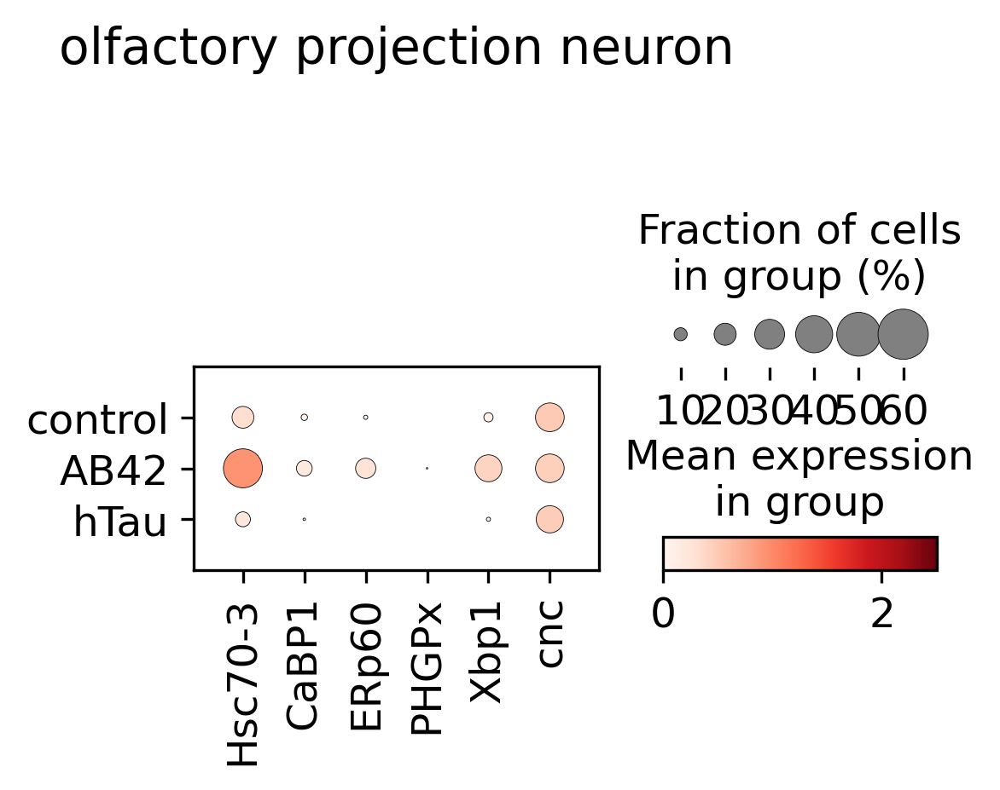

In [166]:
for celltype in cellType_L:
    celltypeName = '_'.join(celltype.split('/'))
    sc.pl.dotplot(adata_head[adata_head.obs.adfca_annotation == celltype], var_names=['Hsc70-3', 'CaBP1', 'ERp60', 'PHGPx', 'Xbp1', 'cnc'], groupby='genotype', title=f'{celltype}', 
                 dot_max=0.6, vmax=2.5, save=f'_ERstressGenes_{celltypeName}.pdf')

In [167]:
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

# Finished